### 1. Data Preparation

In [20]:
import warnings
warnings.filterwarnings('ignore')

import random
import momepy
import geopandas as gpd
import matplotlib.pyplot as plt
import osmnx as ox
import networkx as nx
import numpy as np
import libpysal
from shapely.geometry import LineString, Point

In [21]:
# set the parameters
target_crs=27700 # UK
coords = (53.4063332, -2.9881848) # John Lennon Statue, Cavern Quarter, Liverpool, UK
radius = 100 # to be used for clipped plot

In [22]:
# get building footprints
gdf = ox.features.features_from_point(coords, tags={'building':True}, dist=750)
buildings = ox.projection.project_gdf(gdf)

buildings = buildings[buildings.geom_type == "Polygon"].reset_index(drop=True)
buildings = buildings[["geometry"]].to_crs(target_crs)
buildings["uID"] = range(len(buildings))

In [23]:
# get streets
osm_graph = ox.graph_from_point(coords,
                                network_type='walk', #all_private
                                dist=1000)

streets = ox.graph_to_gdfs(
    osm_graph,
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True)

streets = momepy.remove_false_nodes(streets)
streets = streets[["geometry"]].to_crs(target_crs)
streets["nID"] = range(len(streets))

/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/geopandas/array.py:1459: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))


In [24]:
# get railways
ox.config(log_console=True, use_cache=True)

# osm_graph = ox.graph_from_point((53.4045097, -2.9964016),
#                                 network_type='all_private',
#                                 custom_filter = '["railway"~"rail"]',
#                                 dist=750)

osm_graph = ox.graph_from_point(coords,
                                network_type='all_private',
                                custom_filter = '["railway"~"rail"]',
                                dist=1000)

railways = ox.graph_to_gdfs(
    osm_graph,
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True)

railways = momepy.remove_false_nodes(railways)
railways = railways[["geometry"]].to_crs(target_crs)
railways["nID"] = range(len(railways))

/var/folders/_n/l2f9tkgn3g17dj7hnsjprssc0000gn/T/ipykernel_11285/1104836511.py:2: UserWarning: The `utils.config` function is deprecated and will be removed in a future release. Instead, use the `settings` module directly to configure a global setting's value. For example, `ox.settings.log_console=True`.
  ox.config(log_console=True, use_cache=True)
/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/geopandas/array.py:1459: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))


In [25]:
# combine streets and railways
streets_railways = gpd.overlay(streets, railways, how='union')

/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
/var/folders/_n/l2f9tkgn3g17dj7hnsjprssc0000gn/T/ipykernel_11285/667990642.py:2: UserWarning: `keep_geom_type=True` in overlay resulted in 119 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  streets_railways = gpd.overlay(streets, railways, how='union')


### 2. Enclosed Tessellation & Contiguity Matrix

/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/geopandas/array.py:1459: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as OSGB36 / British National Grid (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))
/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/momepy/elements.py:457: FutureWarning: The `query_bulk()` method is deprecated and will be removed in GeoPandas 1.0. You can use the `query()` method instead.
  inp, res = buildings.sindex.query_bulk(
/var/folders/_n/l2f9tkgn3g17dj7hnsjprssc0000gn/T/ipykernel_11285/172359899.py:6: UserWarning: dask.dataframe could not be imported. Setting `use_dask=False`.
  enclosed_tess = momepy.Tessellation(buildings, unique_id='uID', enclosures=enclosures, segment=1).tessellation
/Users/yutasato/miniconda3/envs/proposal/lib/python3.11/site-packages/pandas/core/arraylike.py:489: RuntimeWarning: invalid value encountered in int

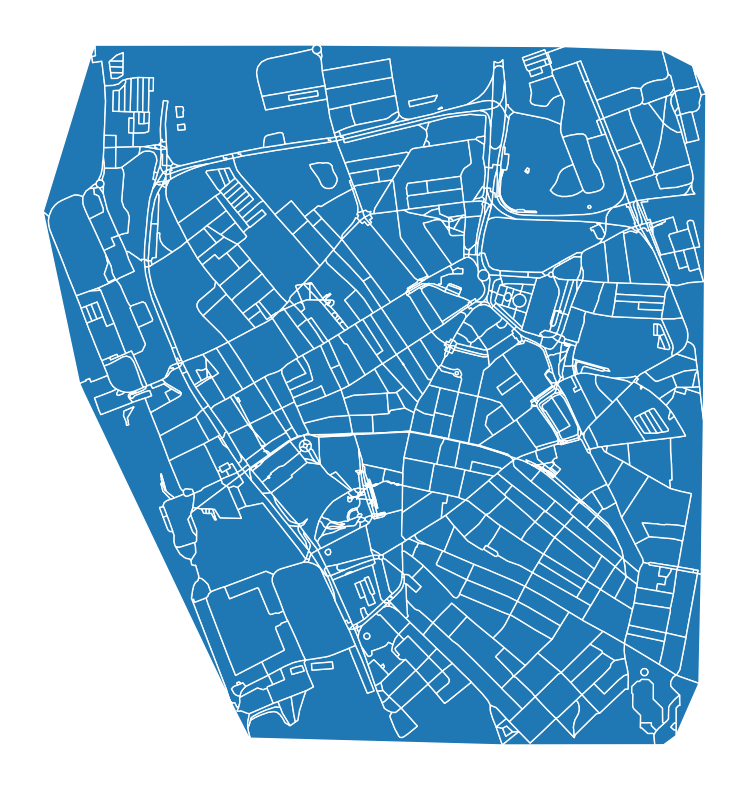

In [99]:
convex_hull = streets.unary_union.convex_hull
enclosures = momepy.enclosures(streets_railways, limit=gpd.GeoSeries([convex_hull]))

enclosures.plot(figsize=(10, 10), edgecolor='w').set_axis_off()

enclosed_tess = momepy.Tessellation(buildings, unique_id='uID', enclosures=enclosures, segment=1).tessellation

In [100]:
w_queen = libpysal.weights.Queen.from_dataframe(enclosed_tess, geom_col='geometry')
w_queen_nx = w_queen.to_networkx()

coordinates = np.stack([enclosed_tess.centroid.geometry.x, enclosed_tess.centroid.geometry.y], axis=1)
positions = {node: tuple(coordinate) for node, coordinate in zip(w_queen_nx.nodes, coordinates)}

nx.set_node_attributes(w_queen_nx, enclosed_tess.centroid.geometry.x, "x")
nx.set_node_attributes(w_queen_nx, enclosed_tess.centroid.geometry.y, "y")

node_data = w_queen_nx.nodes(data=True)
starts, ends, edge_data = zip(*w_queen_nx.edges(data=True))

edge_geometry = {(starts[i], ends[i]):
                 LineString([(node_data[starts[i]]['x'], node_data[starts[i]]['y']),
                             (node_data[ends[i]]['x'], node_data[ends[i]]['y'])])
                for i in range(len(edge_data))}

nx.set_edge_attributes(w_queen_nx, edge_geometry, 'geometry')

nodes, edges, W = momepy.nx_to_gdf(w_queen_nx, spatial_weights=True)

nodes = nodes.set_crs(target_crs)
edges = edges.set_crs(target_crs)

w_queen_gdf = momepy.nx_to_gdf(w_queen_nx, points=False, lines=True, spatial_weights=False).set_crs(target_crs)
w_queen_gdf_nodes = w_queen_gdf.geometry.boundary

/var/folders/_n/l2f9tkgn3g17dj7hnsjprssc0000gn/T/ipykernel_11285/12283663.py:20: UserWarning: Approach is not set. Defaulting to 'primal'.
  nodes, edges, W = momepy.nx_to_gdf(w_queen_nx, spatial_weights=True)
/var/folders/_n/l2f9tkgn3g17dj7hnsjprssc0000gn/T/ipykernel_11285/12283663.py:25: UserWarning: Approach is not set. Defaulting to 'primal'.
  w_queen_gdf = momepy.nx_to_gdf(w_queen_nx, points=False, lines=True, spatial_weights=False).set_crs(target_crs)


### 3. Streets Network & Dual Grpah

In [101]:
streets_dual = momepy.gdf_to_nx(streets, approach="dual")
dual_dict = {nodes[:2] for nodes in streets_dual.edges}
streets_dual = gpd.GeoSeries([LineString(nodes) for nodes in dual_dict], crs=target_crs)
streets_dual = gpd.GeoDataFrame(streets_dual, geometry=streets_dual)

streets_nodes = streets.geometry.boundary
streets_dual_nodes = streets_dual.geometry.boundary

### 4. Overview Viz

In [77]:
import folium

m = folium.Map(location=[53.400002, -2.983333], zoom_start=15)

# overlay = folium.Polygon(
#     locations=[(90, -180), (-90, -180), (-90, 180), (90, 180)],
#     fill=True,
#     color='white',
#     fill_color='white',
#     fill_opacity=1
# )
# overlay.add_to(m)

for idx, row in railways.to_crs(4326).iterrows():
    line = folium.PolyLine(
        locations=[(coord[1], coord[0]) for coord in row['geometry'].coords],
        color='red',
        weight=2,
        opacity=0,
        dash_array='5'
    )
    line.add_to(m)

# Add the GeoDataFrame to the Folium map
for idx, row in w_queen_gdf.to_crs(4326).iterrows():
    line = folium.PolyLine(
        locations=[(coord[1], coord[0]) for coord in row['geometry'].coords],
        color='blue',
        weight=2,
        opacity=1,
        dash_array='5'
    )
    line.add_to(m)

# Add the GeoDataFrame to the Folium map
for idx, row in streets_dual.to_crs(4326).iterrows():
    line = folium.PolyLine(
        locations=[(coord[1], coord[0]) for coord in row['geometry'].coords],
        color='red',
        weight=2,
        opacity=1,
        dash_array='5'
    )
    line.add_to(m)
    
for _, r in enclosed_tess.to_crs(4326).iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r["geometry"])#.simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x: {"fillColor": "orange", "dash_array": "5"})
    geo_j.add_to(m)

for _, r in buildings.to_crs(4326).iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r["geometry"])#.simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x: {"fillColor": "blue"})
    geo_j.add_to(m)
    
# Display the map
m

### 5. Viz for Proposal

In [89]:
def clip_vectors(vec: gpd.GeoDataFrame, center_coords: (float), radius: int=100, target_crs: int=4326)  -> gpd.GeoDataFrame:
    """_summary_
    A function which clips the vectors within a circle. 

    Args:
        vec (gpd.GeoDataFrame): an original vector ojbect.
        center_coords (float): a tuple specifying the coordinates of the center.
        radius (int): An integer specifying the radius of the clip. The default is 100.
        target_crs (int): An integer specifying the target CRS. The default is 4326.
        
    Returns:
        clipped_vec (gpd.GeoDataFrame): an original vector ojbect.
    """

    # define the center of the circle (in this example, lon and lat coordinates)
    center = Point(center_coords[::-1])

    # define the radius of the circle (in degrees or any other unit depending on your CRS)
    radius = 200

    # create a GeoSeries with the center point
    circle_center = gpd.GeoSeries(center, crs=4326)
    circle_center = circle_center.to_crs(target_crs)

    # buffer the point to create a circular polygon
    circle = circle_center.buffer(radius)

    # create a GeoDataFrame
    center_gdf = gpd.GeoDataFrame(geometry=circle, crs=target_crs)
    
    # clip the vector
    clipped_vec = gpd.clip(vec.to_crs(target_crs), center_gdf)
    
    return clipped_vec

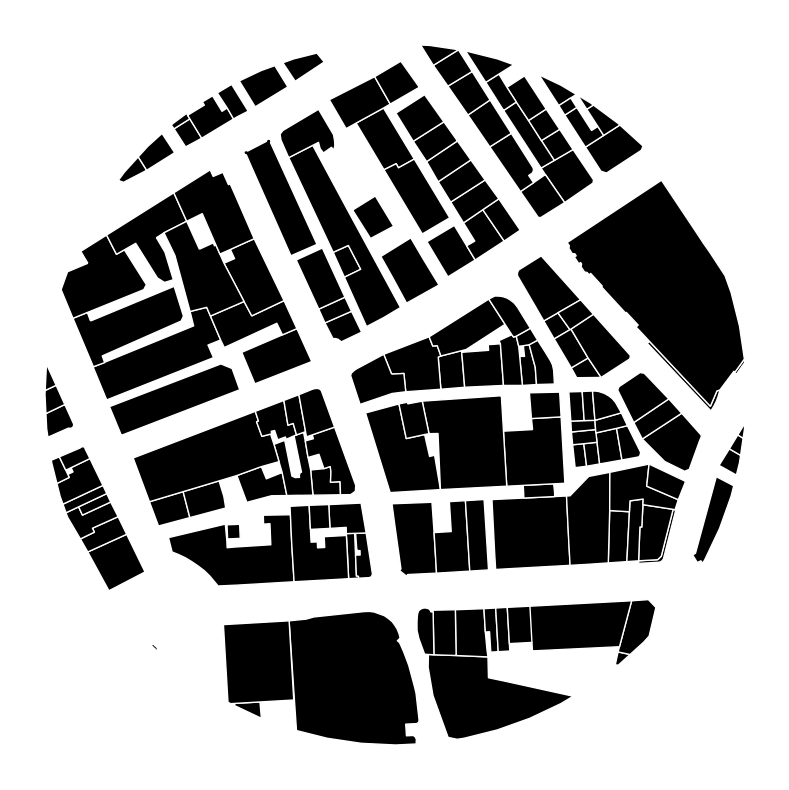

In [90]:
f, ax = plt.subplots(figsize=(10,10))

clip_vectors(buildings, coords, radius, target_crs).plot(color="black", edgecolor="white", ax=ax)

ax.set_axis_off()
plt.show()

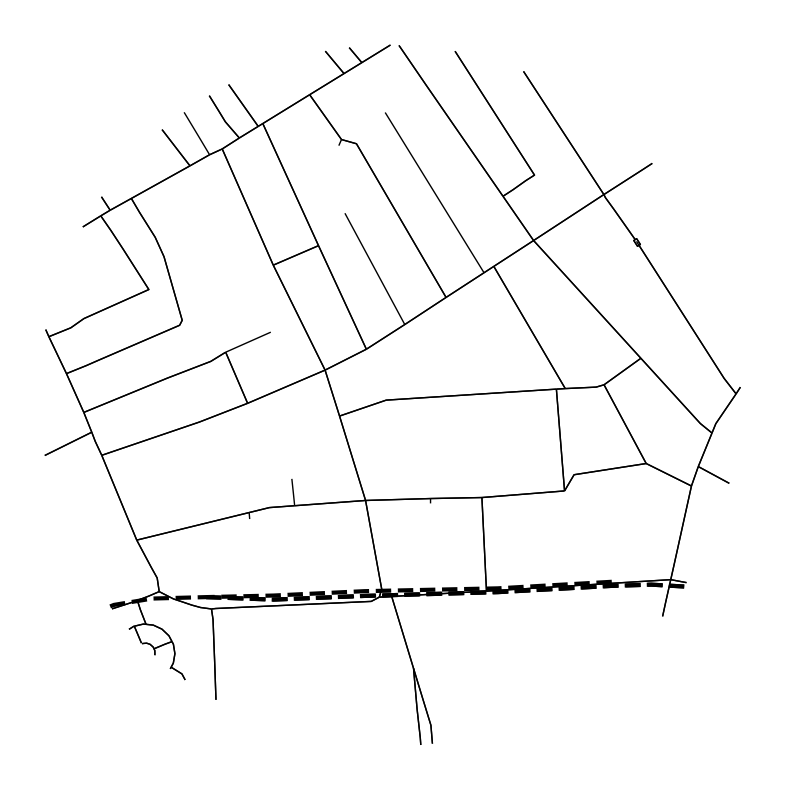

In [91]:
f, ax = plt.subplots(figsize=(10,10))

clip_vectors(streets, coords, radius, target_crs).plot(ax=ax, edgecolor="black", linewidth=1)
clip_vectors(railways, coords, radius, target_crs).plot(ax=ax, ls='--', edgecolor="black",linewidth=3)
# center_gdf.plot(ax=ax, color="none", edgecolor="black")

ax.set_axis_off()
plt.show()

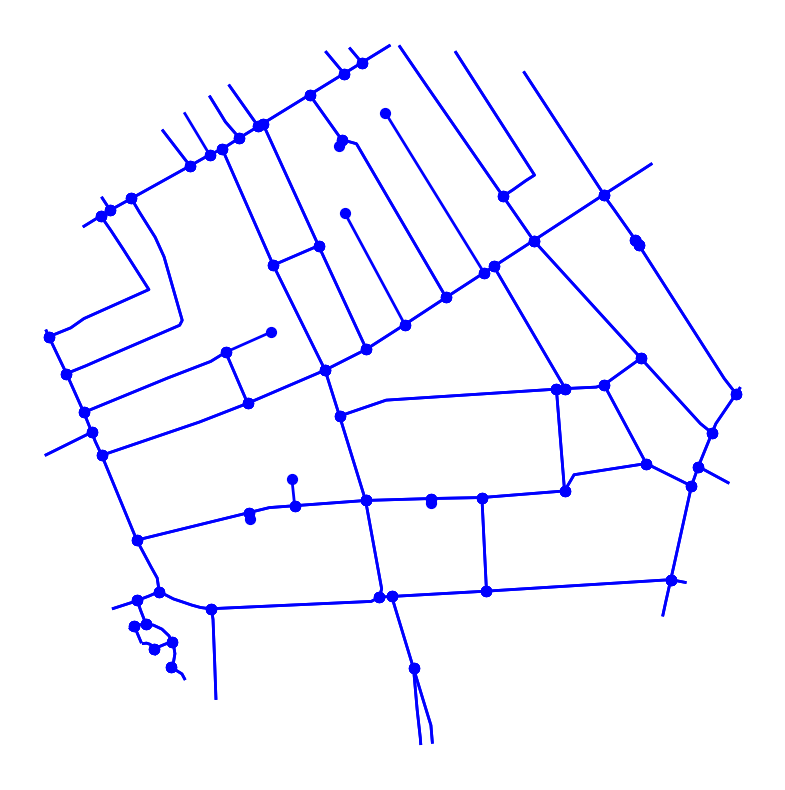

In [130]:
f, ax = plt.subplots(figsize=(10,10))

clip_vectors(streets, coords, radius, target_crs).plot(ax=ax, ls = '-', edgecolor="blue", linewidth=2)
clip_vectors(streets_nodes, coords, radius, target_crs).plot(ax=ax, color="blue", markersize=50)
# center_gdf.plot(ax=ax, color="none", edgecolor="black")

ax.set_axis_off()
plt.show()

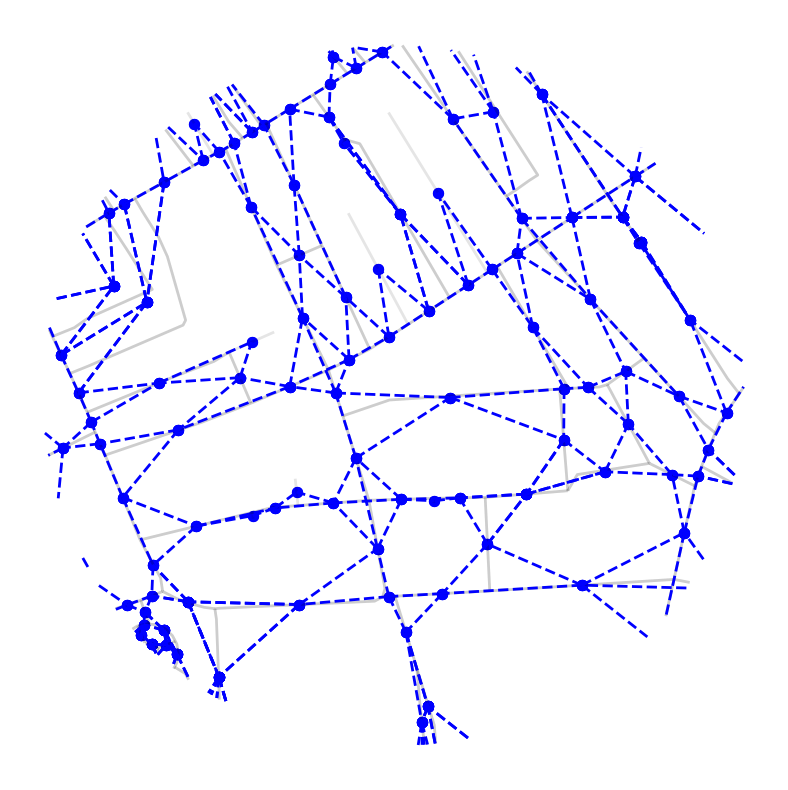

In [117]:
f, ax = plt.subplots(figsize=(10,10))

clip_vectors(streets, coords, radius, target_crs).plot(ax=ax, ls = '-', edgecolor="black", linewidth=2, alpha=.1)
clip_vectors(streets_dual, coords, radius, target_crs).plot(ax=ax, ls = '--', edgecolor="blue", linewidth=2)
clip_vectors(streets_dual_nodes, coords, radius, target_crs).plot(ax=ax, color="blue", markersize=50)
# center_gdf.plot(ax=ax, color="none", edgecolor="black")

ax.set_axis_off()
plt.show()

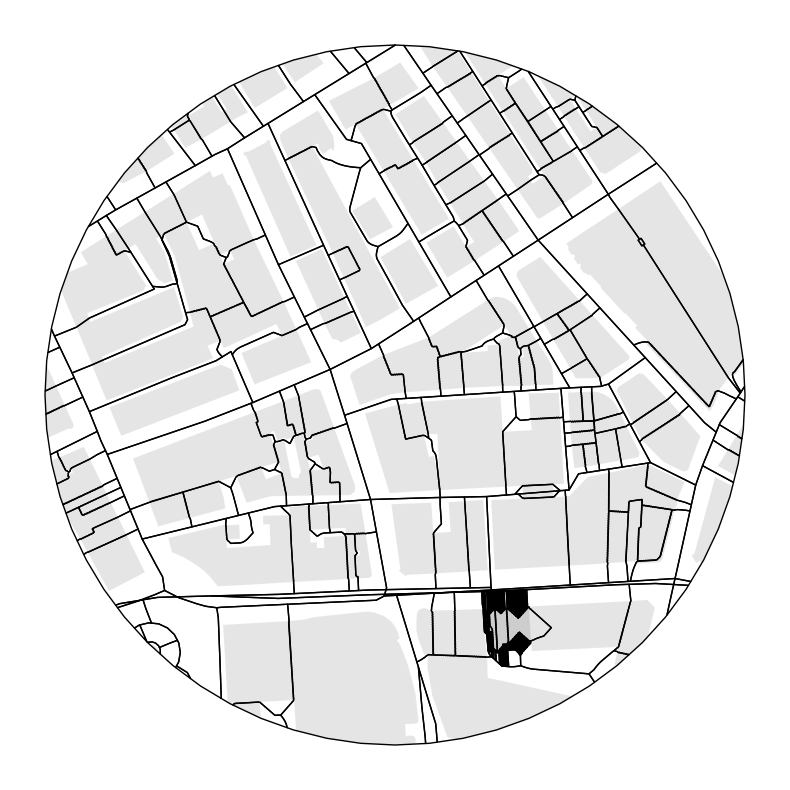

In [118]:
f, ax = plt.subplots(figsize=(10,10))

clip_vectors(buildings, coords, radius, target_crs).plot(color="black", edgecolor="white", ax=ax, alpha=.1)
clip_vectors(enclosed_tess, coords, radius, target_crs).plot(ax=ax, color="none", edgecolor="black", linewidth=1)
# center_gdf.plot(ax=ax, color="none", edgecolor="black")

ax.set_axis_off()
plt.show()

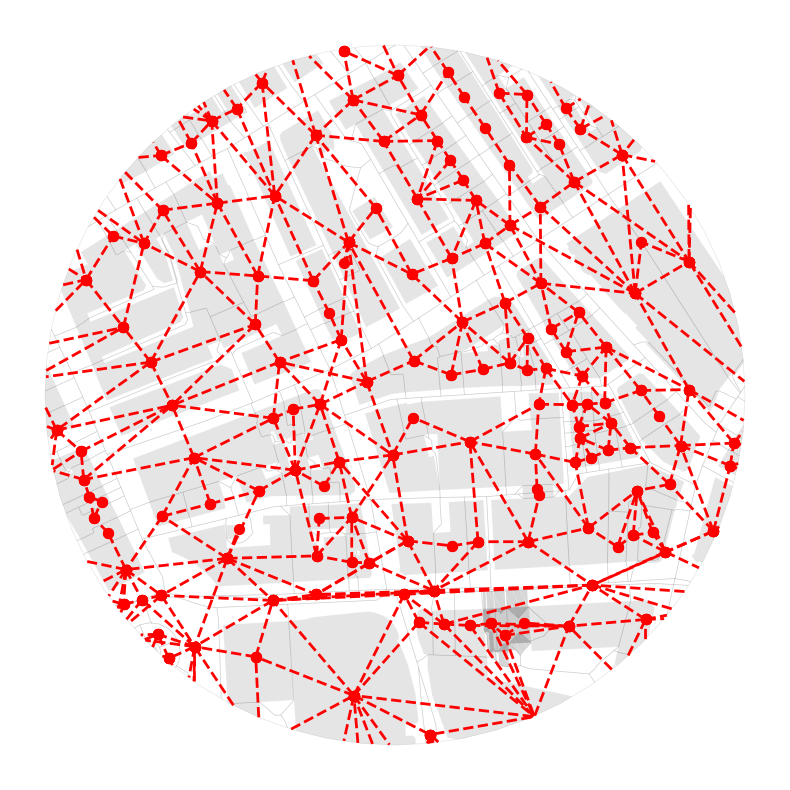

In [116]:
f, ax = plt.subplots(figsize=(10,10))

# center_gdf.plot(ax=ax, color="none", edgecolor="black")
clip_vectors(buildings, coords, radius, target_crs).plot(color="black", edgecolor="white", ax=ax, alpha=.1)
clip_vectors(enclosed_tess, coords, radius, target_crs).plot(ax=ax, color="none", edgecolor="black", linewidth=.5, alpha=.1)
clip_vectors(w_queen_gdf, coords, radius, target_crs).plot(ax=ax, ls = '--', edgecolor="red", linewidth=2)
clip_vectors(w_queen_gdf_nodes, coords, radius, target_crs).plot(ax=ax, color="red", markersize=50)
# streets_dual_clipped.plot(ax=ax, ls = '--', edgecolor="blue", linewidth=1)
# streets_dual_nodes_clipped.plot(ax=ax, color="blue", markersize=15)


ax.set_axis_off()
plt.show()

In [131]:
colors = random.choices(['r','b','y','c'], k=len(clip_vectors(enclosed_tess, coords, radius, target_crs)))

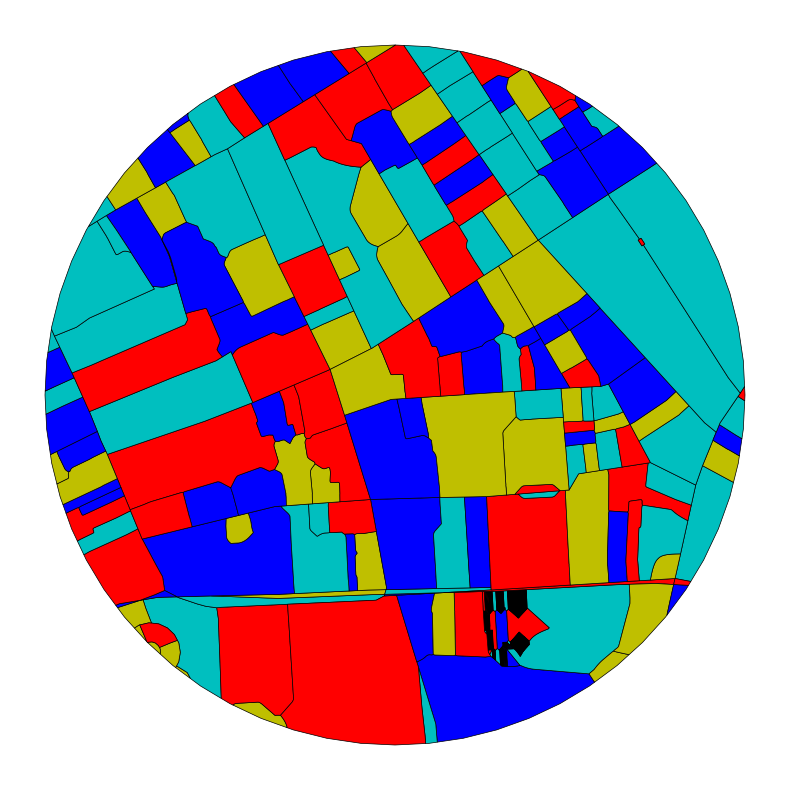

In [135]:
f, ax = plt.subplots(figsize=(10,10))

# center_gdf.plot(ax=ax, color="none", edgecolor="black")
clip_vectors(buildings, coords, radius, target_crs).plot(color="black", edgecolor="white", ax=ax, alpha=.1)
clip_vectors(enclosed_tess, coords, radius, target_crs).plot(ax=ax, color=colors, edgecolor="black", linewidth=.5, alpha=1)
# clip_vectors(w_queen_gdf, coords, radius, target_crs).plot(ax=ax, ls = '--', edgecolor="red", linewidth=2)
# clip_vectors(w_queen_gdf_nodes, coords, radius, target_crs).plot(ax=ax, color="red", markersize=50)
# streets_dual_clipped.plot(ax=ax, ls = '--', edgecolor="blue", linewidth=1)
# streets_dual_nodes_clipped.plot(ax=ax, color="blue", markersize=15)


ax.set_axis_off()
plt.show()

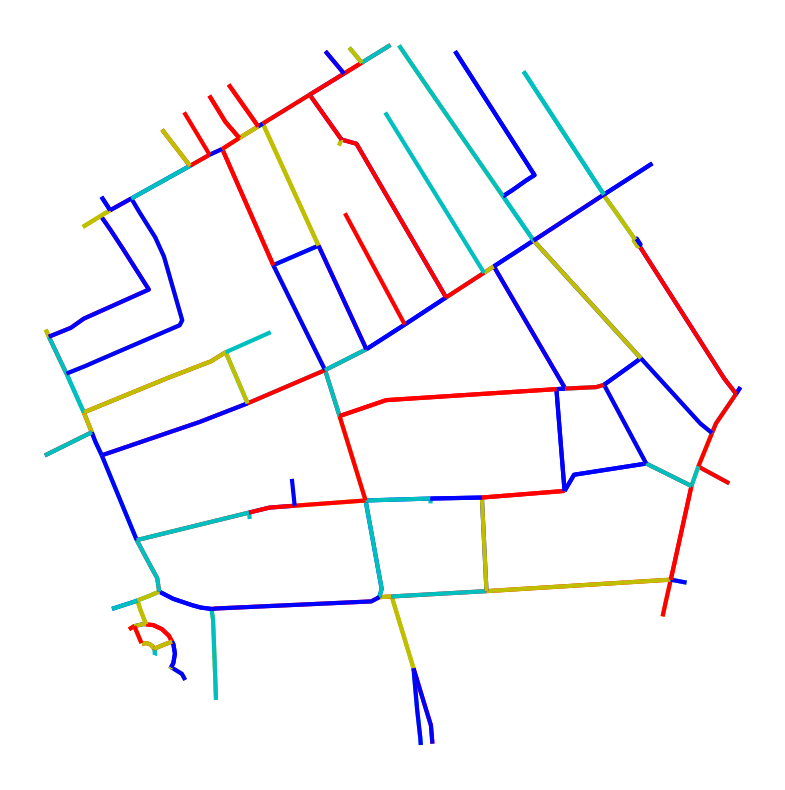

In [140]:
colors = random.choices(['r','b','y','c'], k=len(clip_vectors(streets, coords, radius, target_crs)))

f, ax = plt.subplots(figsize=(10,10))

# center_gdf.plot(ax=ax, color="none", edgecolor="black")
# clip_vectors(buildings, coords, radius, target_crs).plot(color="black", edgecolor="white", ax=ax, alpha=.1)
clip_vectors(streets, coords, radius, target_crs).plot(ax=ax, color=colors, edgecolor="black", linewidth=3, alpha=1)
# clip_vectors(w_queen_gdf, coords, radius, target_crs).plot(ax=ax, ls = '--', edgecolor="red", linewidth=2)
# clip_vectors(w_queen_gdf_nodes, coords, radius, target_crs).plot(ax=ax, color="red", markersize=50)
# streets_dual_clipped.plot(ax=ax, ls = '--', edgecolor="blue", linewidth=1)
# streets_dual_nodes_clipped.plot(ax=ax, color="blue", markersize=15)


ax.set_axis_off()
plt.show()